# Advanced Lane Finding

---

This project contains the pipeline to process images or videos and identify the lane on the road primarily using OpenCV and NumPy packages.

The steps to achieving the result are:

* Find the calibration matrix and distortion coefficient from the provided chessboard images 
* Apply the calibration parameters to the input image to get an undistorted image
* Use color and gradient thresholding to get a binary image
* Apply a perspective transform to the image to obtain a top-view image
* Detect the lane pixels and fit a polynomial to each lane line
* Calculate the curvature of the lane polynomials and find the vehicle's distance off-center
* Transform the detected lines back to the original perspective onto the original image
* Apply a color layer on the lane area and display the values of curvature and vehicle position

---

## Import Packages

Some useful packages that are used in the project are:

* OpenCV: camera calibration, perspective transform, color and gradient thresholding
* NumPy: processing binary image, mapping the detected lane pixels, fitting polynomials
* Matplotlib: displaying images and plotting axes along the way
* OS: manipulating working directory for reading/writing files 

In [136]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import os
%matplotlib inline

---

## Camera Calibration

### Prepare test images

In [3]:
import glob
calibration_images = glob.glob('camera_cal/calibration*.jpg')
calibration_images

['camera_cal/calibration5.jpg',
 'camera_cal/calibration4.jpg',
 'camera_cal/calibration6.jpg',
 'camera_cal/calibration7.jpg',
 'camera_cal/calibration3.jpg',
 'camera_cal/calibration2.jpg',
 'camera_cal/calibration1.jpg',
 'camera_cal/calibration20.jpg',
 'camera_cal/calibration19.jpg',
 'camera_cal/calibration18.jpg',
 'camera_cal/calibration15.jpg',
 'camera_cal/calibration14.jpg',
 'camera_cal/calibration16.jpg',
 'camera_cal/calibration17.jpg',
 'camera_cal/calibration13.jpg',
 'camera_cal/calibration12.jpg',
 'camera_cal/calibration10.jpg',
 'camera_cal/calibration11.jpg',
 'camera_cal/calibration9.jpg',
 'camera_cal/calibration8.jpg']

### Undistort the chessboard images

Prepare values and arrays for undistorting the chessboard images

In [355]:
# Define number of corners in the x and y axes
nx = 9
ny = 6

# Prepare arrays for object and image point coordinates
objpoints = []
imgpoints = []

objp = np.zeros((nx*ny, 3), np.float32)
objp[:, :2] = np.mgrid[0:nx, 0:ny].T.reshape(-1, 2)

Draw chessboard corners if found, then append the images, corners, and object points to their respective arrays

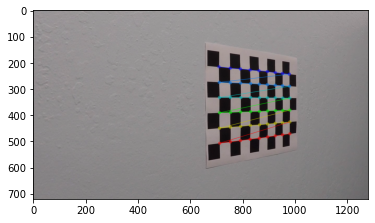

In [389]:
# Array for output chessboard images from camera calibration
out_cal = []

# Undistort each image and append to the array
for fname in calibration_images:
    chessboard = cv2.imread(fname)
    gray = cv2.cvtColor(chessboard, cv2.COLOR_BGR2GRAY)
    ret, corners = cv2.findChessboardCorners(gray, (nx, ny), None)
    
    if ret == True:
        imgpoints.append(corners)
        objpoints.append(objp)
        
        img = cv2.drawChessboardCorners(chessboard, (nx, ny), corners, ret)
        plt.imshow(chessboard)
        out_cal.append(chessboard)

Output the undistorted chessboard images to the folder

In [390]:
count = 1 # Count for naming files
directory = "output_images/draw_chessboard_corners/"
os.chdir(directory)

# Output the files to the folder
for img in out_cal:
    out_fname = "draw_corners" + str(count) + ".jpg"
    cv2.imwrite(out_fname,cv2.cvtColor(img, cv2.COLOR_RGB2BGR))
    count += 1

Undistort the images with the prepared object points and image points

In [357]:
def cal_undistort(img, objpoints, imgpoints):
    """
    Calculates the calibration matrix (mtx) and distortion coefficient (dist).
    
    Returns the undistorted image (undist), mtx, and dist.
    """
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    
    return undist, mtx, dist

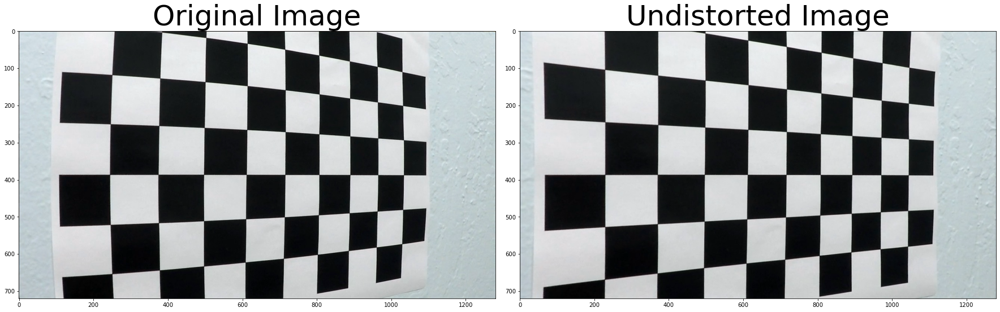

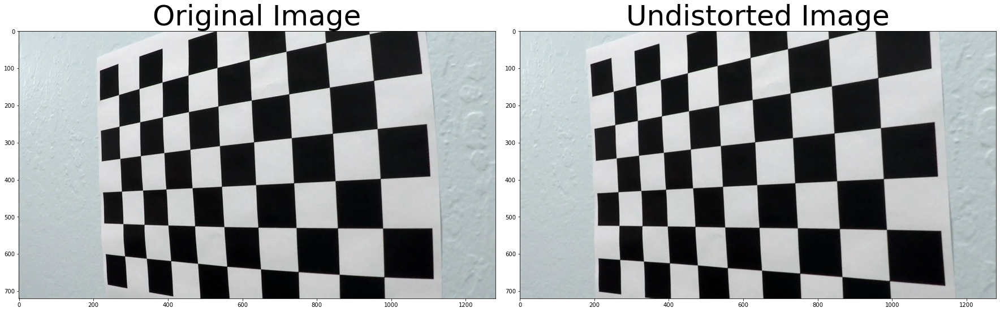

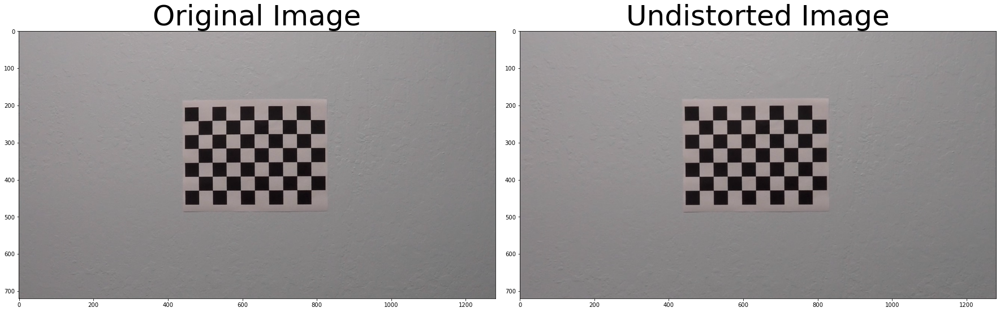

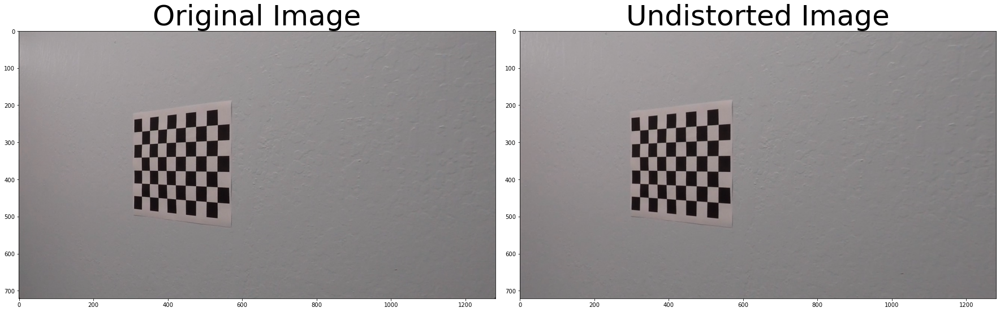

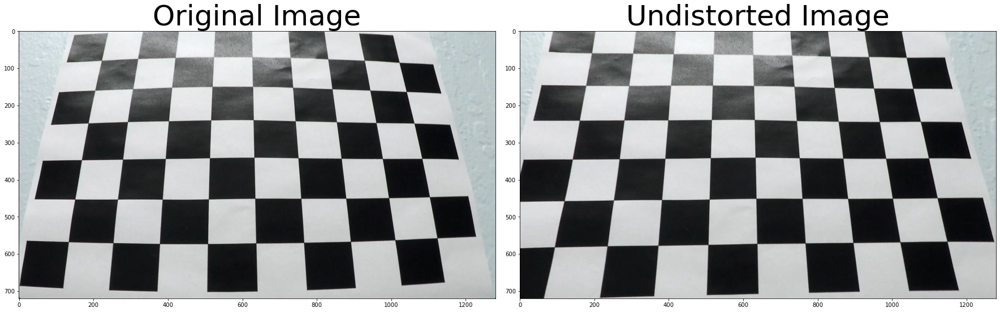

...

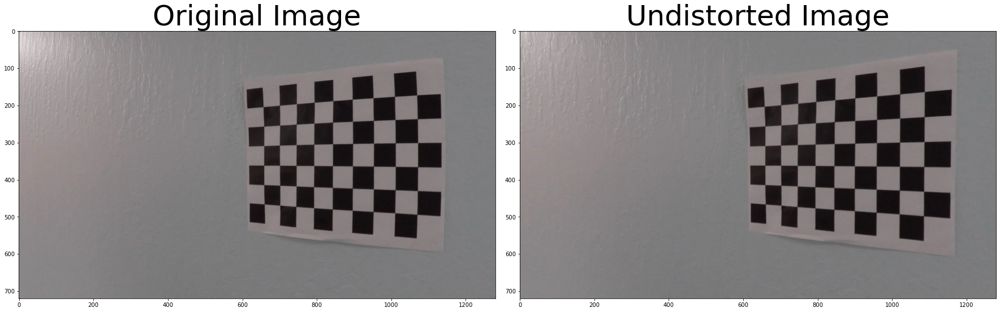

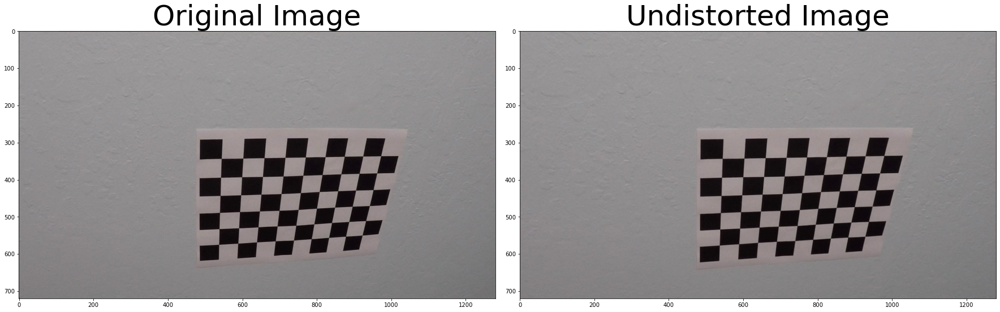

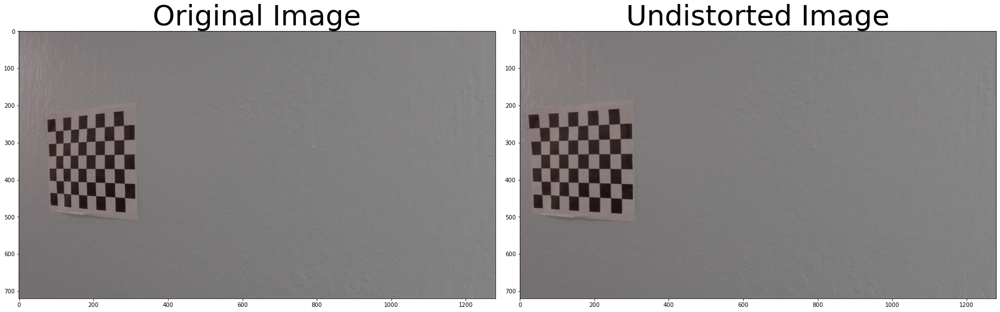

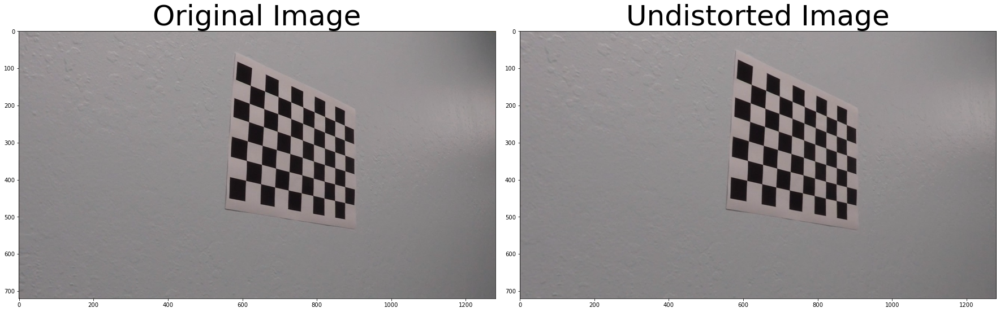

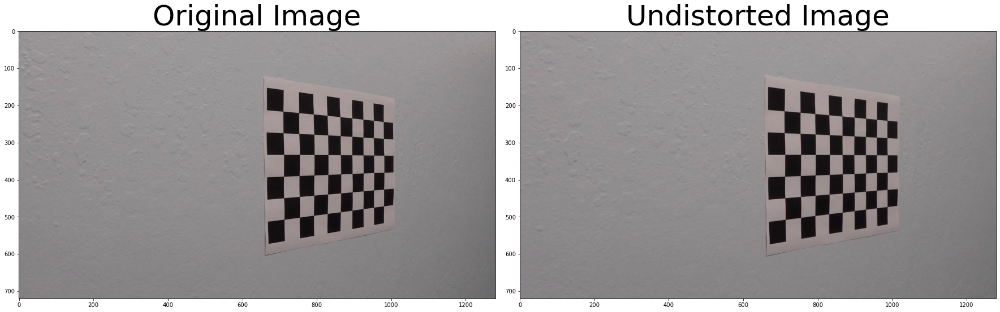

In [375]:
for fname in calibration_images: 
    img = cv2.imread(fname)

    undistorted, mtx, dist = cal_undistort(img, objpoints, imgpoints)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=50)
    ax2.imshow(undistorted)
    ax2.set_title('Undistorted Image', fontsize=50)
    plt.subplots_adjust(left=0., right=1., top=0.9, bottom=0.)
    plt.savefig('output_images/chessboard_undist/cb_undist' + fname[22:])

---

## Applying the pipeline to real images

### Read in an image

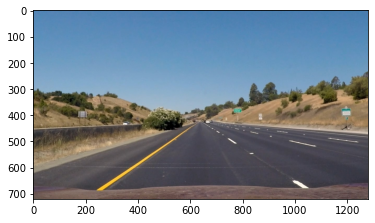

In [503]:
lane_image_raw = cv2.imread('../../test_images/straight_lines1.jpg')
image = cv2.cvtColor(lane_image_raw, cv2.COLOR_BGR2RGB)
plt.imshow(image)

---

## Calibrate the camera

Find the calibration matrix and distortion coefficient from the given chessboard images

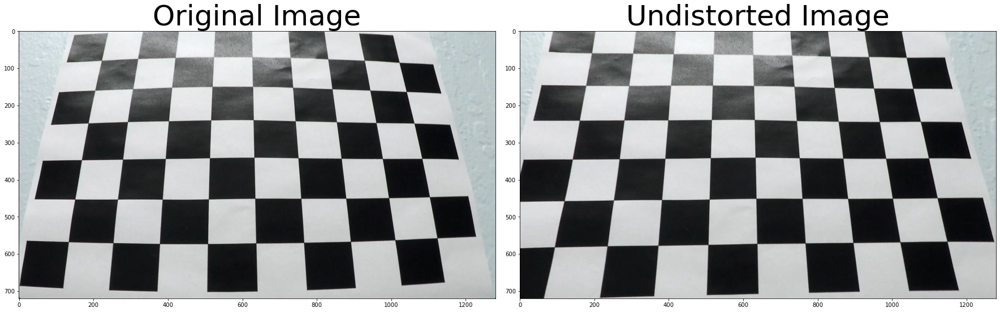

In [181]:
cal_img = cv2.imread('camera_cal/calibration3.jpg')

undistorted_cal, mtx, dist = cal_undistort(cal_img, objpoints, imgpoints)
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(cal_img)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(undistorted_cal)
ax2.set_title('Undistorted Image', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

---

## Undistort the image

Use the calculated matrix and coefficient to undistort the image of the road

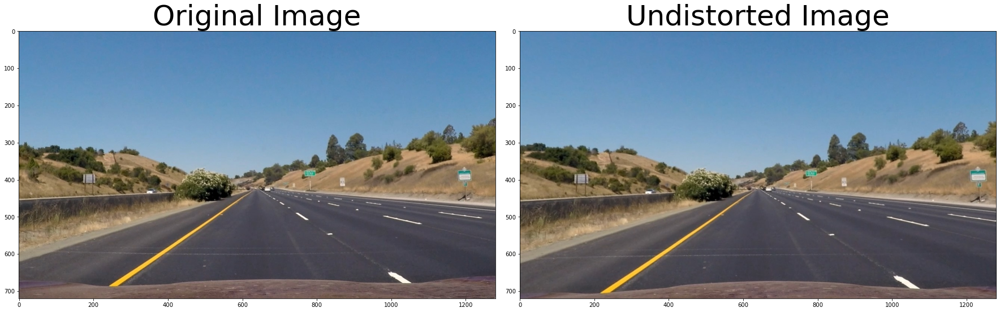

In [584]:
undist = cv2.undistort(image, mtx, dist, None, mtx)
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(image)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(undist)
ax2.set_title('Undistorted Image', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
plt.savefig('../../output_images/undist.jpg')

---

## Color and Gradient Thresholding

### Color thresholding in the HSV space

In [206]:
"""
Helper functions to fine-tune and help find the best thresholding parameter
"""

def h_hls_select(img, thresh=(0, 255)):
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    H = hls[:,:,0]
    binary_output = np.zeros_like(H)
    binary_output[(H > thresh[0]) & (H <= thresh[1])] = 1
    return binary_output

def l_hls_select(img, thresh=(0, 255)):
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    L = hls[:,:,1]
    binary_output = np.zeros_like(L)
    binary_output[(L > thresh[0]) & (L <= thresh[1])] = 1
    return binary_output

def s_hls_select(img, thresh=(0, 255)):
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    S = hls[:,:,2]
    binary_output = np.zeros_like(S)
    binary_output[(S > thresh[0]) & (S <= thresh[1])] = 1
    return binary_output

def h_hsv_select(img, thresh=(0, 255)):
    hsv = cv2.cvtColor(img, cv2.COLOR_RGB2HSV)
    H = hsv[:,:,0]
    binary_output = np.zeros_like(H)
    binary_output[(H > thresh[0]) & (H <= thresh[1])] = 1
    return binary_output

def s_hsv_select(img, thresh=(0, 255)):
    hsv = cv2.cvtColor(img, cv2.COLOR_RGB2HSV)
    S = hsv[:,:,1]
    binary_output = np.zeros_like(S)
    binary_output[(S > thresh[0]) & (S <= thresh[1])] = 1
    return binary_output

def v_hsv_select(img, thresh=(0, 255)):
    hsv = cv2.cvtColor(img, cv2.COLOR_RGB2HSV)
    V = hsv[:,:,2]
    binary_output = np.zeros_like(V)
    binary_output[(V > thresh[0]) & (V <= thresh[1])] = 1
    return binary_output

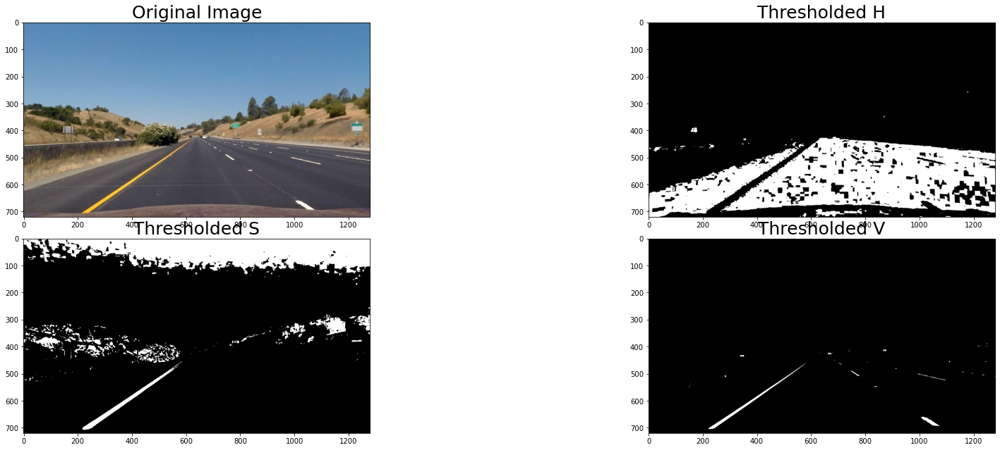

In [505]:
# Try experimenting with different threshold values to find the best one

# HSV
h_binary = h_hsv_select(undist, thresh=(120, 255))
s_binary = s_hsv_select(undist, thresh=(130, 255))
v_binary = v_hsv_select(undist, thresh=(220, 255))

# Plot the result
f, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(undist)
ax1.set_title('Original Image', fontsize=25)
ax2.imshow(h_binary, cmap='gray')
ax2.set_title('Thresholded H', fontsize=25)
ax3.imshow(s_binary, cmap='gray')
ax3.set_title('Thresholded S', fontsize=25)
ax4.imshow(v_binary, cmap='gray')
ax4.set_title('Thresholded V', fontsize=25)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

We decided to use the V-channel of the HSV color space as we can obtain a clear outline of the lane lines.

In [506]:
def threshold_pipeline(img, v_thresh=(220, 255), sx_thresh=(8, 100)):
    """
    Takes the image, V-channel threshold levels, and x-gradient threshold levels
    and applies thresholding with respect to those values.
    
    Returns a binary image with combined thresholding
    """
    img = np.copy(img)
    
    # Convert to HSV color space and separate the V channel
    hsv = cv2.cvtColor(img, cv2.COLOR_RGB2HSV)
    v_channel = hsv[:,:,2]
    
    # Sobel x
    sobelx = cv2.Sobel(v_channel, cv2.CV_64F, 1, 0) # Take the derivative in x
    abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
    scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))
    
    # Threshold x gradient
    sxbinary = np.zeros_like(v_channel)
    sxbinary[(scaled_sobel >= sx_thresh[0]) & (scaled_sobel <= sx_thresh[1])] = 1
    
    # Threshold color channel
    v_binary = np.zeros_like(v_channel)
    v_binary[(v_channel >= v_thresh[0]) & (v_channel <= v_thresh[1])] = 1
    
    # Stack each channel
    # color_binary = np.dstack((np.zeros_like(sxbinary), sxbinary, v_binary)) * 255
    thresh_binary = v_binary | sxbinary
    
    return thresh_binary

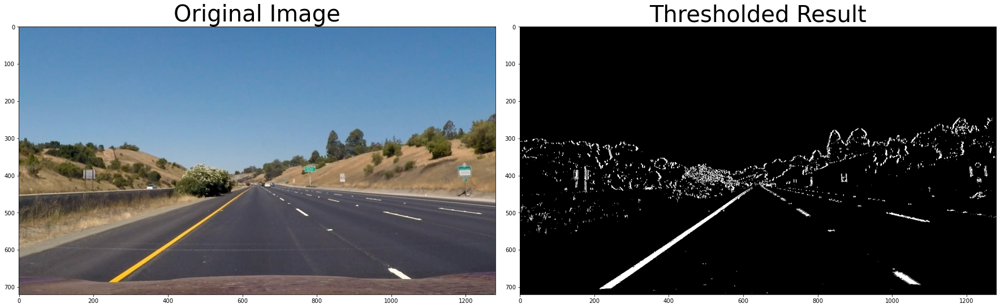

In [585]:
# V-channel thresholds (blue)
v_thresh = (225, 255)

# x-gradient thresholds (green)
sx_thresh = (30, 100)

# Apply the thresholds
binary = threshold_pipeline(undist, v_thresh, sx_thresh)

# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()

ax1.imshow(image)
ax1.set_title('Original Image', fontsize=40)

ax2.imshow(binary, cmap='gray')
ax2.set_title('Thresholded Result', fontsize=40)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
plt.savefig('../../output_images/thresholded_binary.jpg')

---

## Perspective transform

First, find the source points from the undistorted image and define the destination points on the warped image.

Then, calculate the transformation matrix (`M`) and its inverse matrix (`Minv`) using those sets of points

In [541]:
# Find reference rectangle for perspective warp
vertices = np.array([[(230,700), (590,450), (690,450), (1080,700)]], dtype=np.int32)

# Draw the region on a copy of the undistorted image
mask = np.copy(undist)
cv2.polylines(mask, [vertices], True, (255,0,0), thickness=3)

# Define the rectangle on the destination top-view image
margin = 300
src = np.float32(vertices)
dst = np.float32([(margin, undist.shape[0]), (margin, 0), 
                  (undist.shape[1]-margin, 0), (undist.shape[1]-margin, undist.shape[0])])

# Calculate the transformation matrix (M) and its inverse matrix (Minv)
M = cv2.getPerspectiveTransform(src, dst)
Minv = cv2.getPerspectiveTransform(dst, src)

Apply the transform to the undistorted image, and draw the quadrilateral representing the region on both images

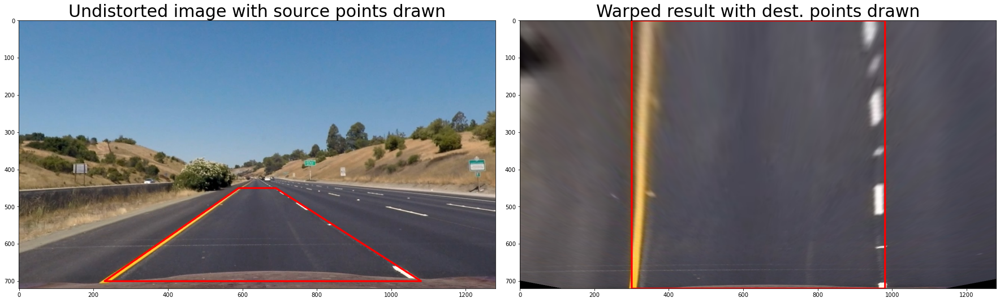

In [586]:
# Transform the image into a top-down view
top_down = cv2.warpPerspective(undist, M, (undist.shape[1], undist.shape[0]))

# Draw the destination region on the warped image
top_mask = np.copy(top_down)
dst_copy = np.array(dst, dtype=np.int32) # Convert dst into a format usable in cv2.polylines()
cv2.polylines(top_mask, [dst_copy], True, (255,0,0), thickness=3)

# Display the two images
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()

ax1.imshow(mask)
ax1.set_title('Undistorted image with source points drawn', fontsize=30)

ax2.imshow(top_mask)
ax2.set_title('Warped result with dest. points drawn', fontsize=30)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
plt.savefig('../../output_images/warped_points.jpg')

Apply perspective transform to the binary image before using it to detect lane pixels in the next step

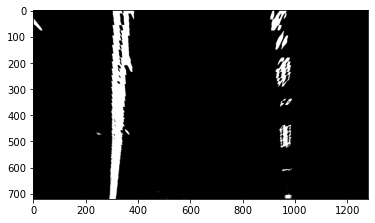

In [543]:
# Apply perspective transform to the binary image
binary_warped = cv2.warpPerspective(binary, M, (undist.shape[1], undist.shape[0]))
plt.imshow(binary_warped, cmap='gray')

---

## Identify lane pixels

### Find Histogram Peaks

We will be using the histogram peaks to start out the base of our lane line.

The histogram from `hist()` plots the sum of the pixels on the bottom half of the image.

In [212]:
def hist(img):
    # Grab only the bottom half of the image
    # Lane lines are likely to be mostly vertical nearest to the car
    bottom_half = img[img.shape[0]//2:,:]

    # Sum across image pixels vertically
    histogram = np.sum(bottom_half, axis=0)
    
    return histogram

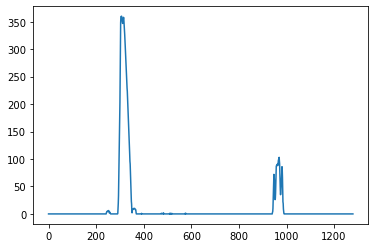

In [545]:
# Plot the sum of pixel values on the bottom half of binary_warped
histogram = hist(binary_warped)
plt.plot(histogram)

### Find the lane pixels and fit a quadratic polynomial onto each side

`find_lane_pixels()` places sliding windows on the lane pixels, starting from the base.

We identify the base by looking at the histogram peaks, and lane identification starts from there.

Then, we move up from the base and find the lane pixels within the set value of `margin`.

If the windows contain pixels more than the set minimum value `minpix`, we will place the window there.

In [591]:
def find_lane_pixels(binary_warped):
    # Take a histogram of the bottom half of the image
    histogram = hist(binary_warped)
    # Create an output image to draw on and visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]//2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # HYPERPARAMETERS
    # Choose the number of sliding windows
    nwindows = 9
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50

    # Set height of windows - based on nwindows above and image shape
    window_height = np.int(binary_warped.shape[0]//nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated later for each window in nwindows
    leftx_current = leftx_base
    rightx_current = rightx_base

    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window + 1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        
        # Find the boundaries of the window
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        
        # Draw the windows on the visualization image
        cv2.rectangle(out_img, (win_xleft_low, win_y_low), (win_xleft_high, win_y_high), (0,255,0), 2) 
        cv2.rectangle(out_img, (win_xright_low, win_y_low), (win_xright_high, win_y_high), (0,255,0), 2) 
        
        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high) 
                          & (nonzeroy >= win_y_low) & (nonzeroy < win_y_high)).nonzero()[0]
        good_right_inds = ((nonzerox >= win_xright_low) & (nonzerox < win_xright_high) 
                           & (nonzeroy >= win_y_low) & (nonzeroy < win_y_high)).nonzero()[0]
        
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        
        # If found > minpix pixels, recenter next window on their mean position
        if (len(good_left_inds) > minpix):
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if (len(good_right_inds) > minpix):
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices (previously was a list of lists of pixels)
    try:
        left_lane_inds = np.concatenate(left_lane_inds)
        right_lane_inds = np.concatenate(right_lane_inds)
    except ValueError:
        # Avoids an error if the above is not implemented fully
        pass

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    return leftx, lefty, rightx, righty, out_img


def fit_polynomial(binary_warped):
    # Find our lane pixels first
    leftx, lefty, rightx, righty, out_img = find_lane_pixels(binary_warped)

    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)

    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0])
    
    try:
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    except TypeError:
        # Avoids an error if `left` and `right_fit` are still none or incorrect
        print('The function failed to fit a line!')
        left_fitx = 1*ploty**2 + 1*ploty
        right_fitx = 1*ploty**2 + 1*ploty

    ## Visualization ##
    # Colors in the left and right lane regions
    out_img[lefty, leftx] = [255, 0, 0]
    out_img[righty, rightx] = [0, 0, 255]

    # Plots the left and right polynomials on the lane lines
    ### Comment out the following 2 lines when applying to videos
    plt.plot(left_fitx, ploty, color='yellow')
    plt.plot(right_fitx, ploty, color='yellow')

    return out_img, left_fit, right_fit, ploty

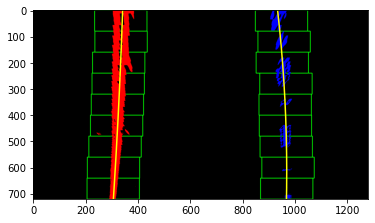

In [589]:
# Map sliding windows on the lane pixels and fit a quadratic polynomial onto each one
poly_windows, left_fit, right_fit, ploty = fit_polynomial(binary_warped)
plt.imshow(poly_windows)
plt.savefig('../../output_images/poly_windows.jpg')

---

## Warp back to original view

Now we apply the inverse transform to the image of detected lane lines and get the original perspective.

Then we cast the lane region over the undistorted original image to visualize our lane.

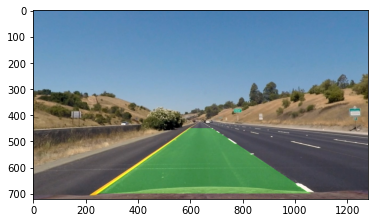

In [553]:
# Create an image to draw the lines on
warp_zero = np.zeros_like(binary_warped).astype(np.uint8)
color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

# Recast the x and y points into usable format for cv2.fillPoly()
ploty = np.linspace(0, warped.shape[0]-1, warped.shape[0] )
left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
pts = np.hstack((pts_left, pts_right))

# Draw the lane onto the warped blank image
cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

# Warp the blank back to original image space using inverse perspective matrix (Minv)
newwarp = cv2.warpPerspective(color_warp, Minv, (undist.shape[1], undist.shape[0])) 
# Combine the result with the original image
result = cv2.addWeighted(undist, 1, newwarp, 0.3, 0)
plt.imshow(result)

---

## Measure the curvature of the lane and the vehicle distance from center

In [552]:
def measure_curvature(ploty, left_fit_cr, right_fit_cr):
    """
    Calculates the curvature of polynomial functions in meters.
    """
    # Define conversions in x and y from pixels space to meters
    # The length of a single dashed line is 3 meters
    ym_per_pix = 3/90 # meters per pixel in y dimension
    
    # The width of a lane line is about 3.7 meters
    xm_per_pix = 3.7/650 # meters per pixel in x dimension
    
    # Define y-value where we want radius of curvature, in this case the bottom of the image
    y_eval = np.max(ploty)
    
    # Calculation of radius of curvature
    left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5)/np.abs(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5)/np.abs(2*right_fit_cr[0])
    
    return left_curverad, right_curverad

def print_curvature(left_cr_m, right_cr_m):
    """
    Returns a string with radius of curvature to be displayed on the image
    """
    avg_cr = round(((left_cr_m + right_cr_m)/2), 2)
    return 'Radius of Curvature = ' + str(avg_cr) + ' m'

In [325]:
def measure_offcenter(img_shape, left_fitx, right_fitx):
    """
    Calculate the distance of the vehicle respect to the lane center
    """
    xm_per_pix = 3.7/650 # meters per pixel in x dimension
    
    img_centerx = img_shape[1]/2
    lane_centerx = (left_fitx[-1] + right_fitx[-1]) / 2
    offcenter_px = lane_centerx - img_centerx
    offcenter_distance = offcenter_px * xm_per_pix
    return offcenter_distance # Returns distance off-center in meters

def print_offcenter(offcenter_distance):
    """
    Returns a string with vehicle location and direction to be displayed on the image
    """
    out_val = round(abs(offcenter_distance), 2)
    out_str = 'Vehicle is ' + str(out_val) + ' m '
    direction = 'left' if offcenter_distance > 0 else 'right'
    return out_str + direction + ' of center'

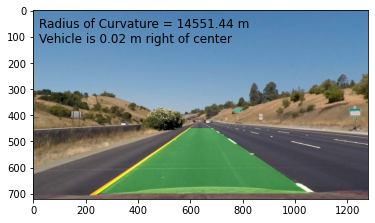

In [590]:
# Calculate the radius of curvature in meters for both lane lines
left_curverad, right_curverad = measure_curvature(ploty, left_fit, right_fit)
curvature_str = print_curvature(left_curverad, right_curverad)

# Calculate the location of the vehicle respect to the lane center
offcenter = measure_offcenter(undist.shape, left_fitx, right_fitx)
offcenter_str = print_offcenter(offcenter)

# Create the on-screen text
onscreen_text = curvature_str + '\n' + offcenter_str

plt.text(20, 120, onscreen_text, fontsize='large')
plt.imshow(result)
plt.savefig('../../output_images/result_with_text.jpg')

---

## Pipeline for images

In [556]:
def image_pipeline(image):
    # Undistort the frame
    undist = cv2.undistort(image, mtx, dist, None, mtx)
    
    # S-channel thresholds (blue)
    s_thresh = (220, 255)

    # x-gradient thresholds (green)
    sx_thresh = (50, 100)
    
    # Apply the threshold to the undistorted image
    binary = threshold_pipeline(undist, s_thresh, sx_thresh)
    
    # Define the vertices of "lane-box" on the undistorted binary image and the margin
    vertices = np.array([[(230,700), (590,450), (690,450), (1080,700)]], dtype=np.int32)
    margin = 300
    src = np.float32(vertices)
    
    # Define the destination rectangle on the perspective-transformed image
    dst = np.float32([(margin, undist.shape[0]), (margin, 0), (undist.shape[1]-margin, 0), 
                      (undist.shape[1]-margin, undist.shape[0])])
    
    # Get the perspective matrix and the inverse matrix
    M = cv2.getPerspectiveTransform(src, dst)
    Minv = cv2.getPerspectiveTransform(dst, src)
    
    # Apply the perspective transformation to the undistorted binary image
    binary_warped = cv2.warpPerspective(binary, M, (undist.shape[1], undist.shape[0]))
    
    # Fit polynomial lines onto the lane lines on the warped image 
    out_img, left_fit, right_fit, ploty = fit_polynomial(binary_warped)
    
    # Create an image to draw the lines on
    warp_zero = np.zeros_like(binary_warped).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

    # Recast the x and y points into usable format for cv2.fillPoly()
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (undist.shape[1], undist.shape[0]))
    
    left_curverad, right_curverad = measure_curvature(ploty, left_fit, right_fit)
    curvature_str = print_curvature(left_curverad, right_curverad)

    offcenter = measure_offcenter(undist.shape, left_fitx, right_fitx)
    offcenter_str = print_offcenter(offcenter)

    onscreen_text = curvature_str + '\n' + offcenter_str
    
    # Combine the result with the original image
    painted = cv2.addWeighted(undist, 1, newwarp, 0.3, 0)
    
    painted_cr = cv2.putText(
        img = painted,
        text = curvature_str,
        org = (80, 80),
        fontFace = cv2.FONT_HERSHEY_DUPLEX,
        fontScale = 2.0,
        color = (0, 0, 0),
        thickness = 3)
    
    result = cv2.putText(
        img = painted_cr,
        text = offcenter_str,
        org = (80, 140),
        fontFace = cv2.FONT_HERSHEY_DUPLEX,
        fontScale = 2.0,
        color = (0, 0, 0),
        thickness = 3)

    return result

Put all test images through the pipeline and save them in the folder `output_images/pipelined_images/`

In [572]:
test_images = glob.glob('../../test_images/*')

for fname in test_images:
    img_in = cv2.imread(fname)
    img_out = image_pipeline(img_in)
    cv2.imwrite('../../output_images/pipelined_images/'+fname[18:], img_out)

---

## Pipeline for videos

In [154]:
from moviepy.editor import VideoFileClip
from IPython.display import HTML

In [580]:
def video_pipeline(fname):
    output_dir = '../../output_videos/' + fname[6:]
    clip1 = VideoFileClip(fname)
    output_clip = clip1.fl_image(image_pipeline)
    %time output_clip.write_videofile(output_dir, audio=False)

In [581]:
test_videos = glob.glob('../../*.mp4')

for fname in test_videos:
    video_pipeline(fname)
    print(fname[6:])

t:   0%|          | 3/1260 [00:00<00:58, 21.50it/s, now=None]

Moviepy - Building video ../../output_videos/project_video.mp4.
Moviepy - Writing video ../../output_videos/project_video.mp4




t:  20%|█▉        | 249/1260 [00:18<01:16, 13.13it/s, now=None]


t:  39%|███▉      | 493/1260 [00:36<00:54, 14.05it/s, now=None]


t:  58%|█████▊    | 737/1260 [00:54<00:36, 14.18it/s, now=None]


t:  78%|███████▊  | 981/1260 [01:11<00:19, 14.23it/s, now=None]


t:  97%|█████████▋| 1221/1260 [01:28<00:02, 13.22it/s, now=None]


t:   0%|          | 2/485 [02:16<9:08:51, 68.18s/it, now=None]  

Moviepy - Done !
Moviepy - video ready ../../output_videos/project_video.mp4
CPU times: user 5min 51s, sys: 29.8 s, total: 6min 21s
Wall time: 1min 32s
project_video.mp4


t:   0%|          | 3/1199 [00:00<01:01, 19.61it/s, now=None]

Moviepy - Building video ../../output_videos/harder_challenge_video.mp4.
Moviepy - Writing video ../../output_videos/harder_challenge_video.mp4




t:  21%|██        | 249/1199 [00:18<01:26, 10.93it/s, now=None]


t:  36%|███▌      | 431/1199 [00:37<01:27,  8.77it/s, now=None]


t:  50%|█████     | 601/1199 [00:51<00:43, 13.66it/s, now=None]

TypeError: expected non-empty vector for x

harder_challenge_video.mp4


                                                              
t:   0%|          | 2/485 [03:09<12:41:23, 94.58s/it, now=None]
                                                               
t:  50%|█████     | 602/1199 [00:52<00:43, 13.66it/s, now=None]

t:   0%|          | 0/485 [00:00<?, ?it/s, now=None]

t:   1%|          | 3/485 [00:00<00:20, 23.32it/s, now=None]

Moviepy - Building video ../../output_videos/challenge_video.mp4.
Moviepy - Writing video ../../output_videos/challenge_video.mp4





t:   1%|          | 5/485 [00:00<00:22, 21.44it/s, now=None]

t:   1%|▏         | 7/485 [00:00<00:23, 20.71it/s, now=None]

t:   2%|▏         | 9/485 [00:00<00:23, 20.19it/s, now=None]

t:   2%|▏         | 11/485 [00:00<00:23, 19.92it/s, now=None]

t:   3%|▎         | 13/485 [00:00<00:23, 19.77it/s, now=None]

t:   3%|▎         | 15/485 [00:00<00:23, 19.62it/s, now=None]

t:   4%|▎         | 17/485 [00:00<00:24, 19.44it/s, now=None]

t:   4%|▍         | 19/485 [00:00<00:24, 19.34it/s, now=None]

t:   4%|▍         | 21/485 [00:01<00:23, 19.47it/s, now=None]

t:   5%|▍         | 23/485 [00:01<00:23, 19.47it/s, now=None]

t:   5%|▌         | 25/485 [00:01<00:23, 19.57it/s, now=None]

t:   6%|▌         | 27/485 [00:01<00:23, 19.50it/s, now=None]

t:   6%|▌         | 29/485 [00:01<00:23, 19.50it/s, now=None]

t:   6%|▋         | 31/485 [00:01<00:23, 19.54it/s, now=None]

t:   7%|▋         | 33/485 [00:01<00:23, 19.41it/s, now=None]

t:   7%|▋         | 35/485 [00:01<00:23, 19.42it/s, now=

TypeError: expected non-empty vector for x

challenge_video.mp4



t:  50%|█████     | 602/1199 [01:02<00:43, 13.66it/s, now=None]

t:  27%|██▋       | 133/485 [00:19<00:21, 16.14it/s, now=None]